In [1]:
import glob
import copy
import pyorc
import numpy as np
import pandas as pd
import xarray as xr
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize

In [2]:
np.random.seed(0)

MONTHS = ['January', 'February', 'March', 'April', 'May', 'June', 'July']

files = []
for month in MONTHS:
    for file in sorted(glob.glob("*.nc", root_dir=f"{month}/results/")):
        files.append({
            "video_file": f"{month}/videos/{file.split('.')[0].rsplit('_', maxsplit=2)[0]}.mp4",
            "vector_file": f"{month}/results/{file}"
        })

# for f in files:
#     print(f)

files = np.random.choice(np.array(files), size=len(files)//10, replace=False)

In [3]:
radar = pd.read_csv('radar/test1.csv')

radar_mean = np.mean(radar[radar['Tilt angle value'] >= 60][' Average velocity value'])
print(f"radar mean velocity: {radar_mean}")

radar mean velocity: 1.6031746031746033


In [ ]:
sns.scatterplot(
    data=radar,
    x='Tilt angle value',
    y=' Average velocity value'
)

In [4]:
# file = files[1]
file = {'video_file': 'July/videos/video_capture_2024-07-01_12-22-37.mp4', 'vector_file': 'July/results/video_capture_2024-07-01_12-22-37_velocimetry_results.nc'}
video_file = file['video_file']
vector_file = file['vector_file']

dataset = xr.open_dataset(vector_file)

In [ ]:
ds = copy.deepcopy(dataset)

# ds.velocimetry.mask.corr(inplace=True)
# ds.velocimetry.mask.minmax(inplace=True)
# ds.velocimetry.mask.rolling(inplace=True)
# ds.velocimetry.mask.outliers(inplace=True)
# ds.velocimetry.mask.variance(inplace=True)
# ds.velocimetry.mask.angle(inplace=True)
# ds.velocimetry.mask.count(inplace=True)

# ds.velocimetry.mask.window_mean(wdw=2, inplace=True, tolerance=0.5, reduce_time=True)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds = ds.mean(dim="time", keep_attrs=True)

ds.velocimetry.plot(
    ax=video.get_frames(method="rgb")[0].frames.plot(mode="camera").axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=1.0, clip=False),
    add_colorbar=True
)
plt.show()
plt.clf()


In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)
plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.minmax(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
nums = [i / 100 for i in range(2,22,2)]
for i in nums:
    print(f"s_min={i}")
    ds = copy.deepcopy(dataset)

    video = pyorc.Video(video_file, start_frame=0, end_frame=125)
    video.camera_config = ds.velocimetry.camera_config

    ds.velocimetry.mask.minmax(s_min=i, s_max=9999, inplace=True)

    ds = ds.mean(dim="time", keep_attrs=True)

    p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

    ds.velocimetry.plot(
        ax=p.axes,
        mode="camera",
        alpha=0.4,
        cmap="rainbow",
        scale=200,
        width=0.0015,
        norm=Normalize(vmin=0., vmax=0.6, clip=False),
        add_colorbar=True
    )

    plt.show()
    plt.clf()

    df = ds.to_dataframe().reset_index()
    df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

    print(f"mean vector length: {np.mean(df.v_len)}")
    sns.histplot(
        data=df,
        x='v_len',
        bins=64
    )
    plt.show()
    plt.clf()

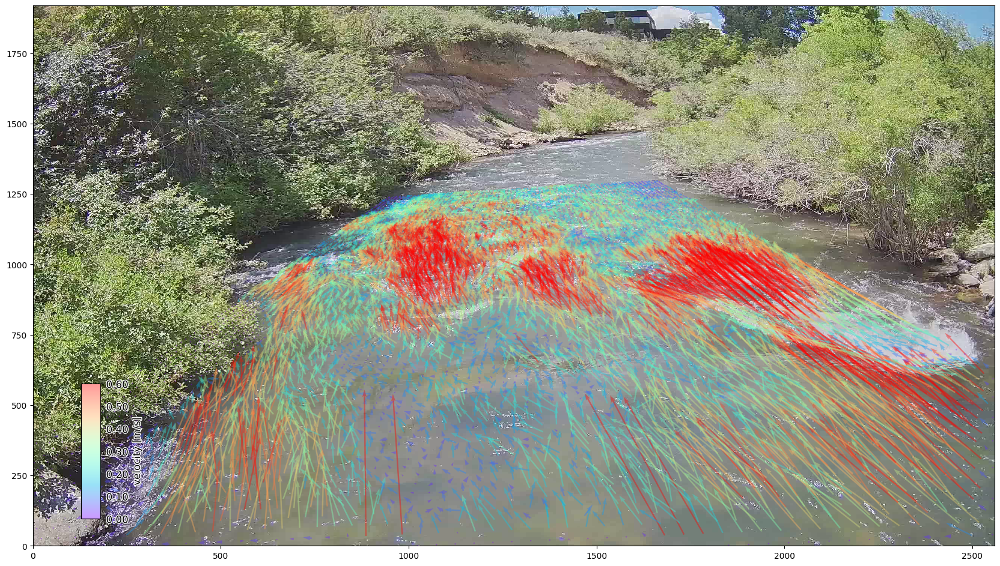

mean vector length: 0.31568667192947336


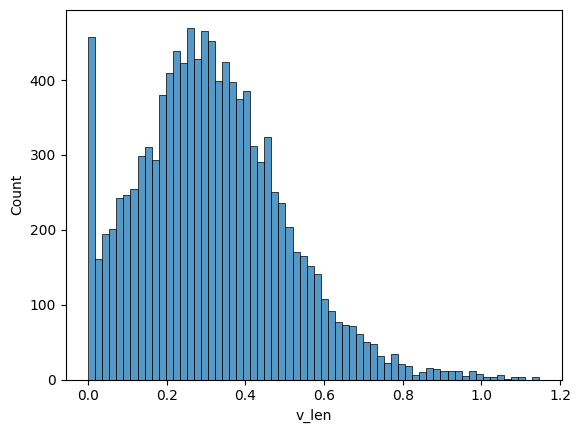

mean correlation value: 0.40256676557423937


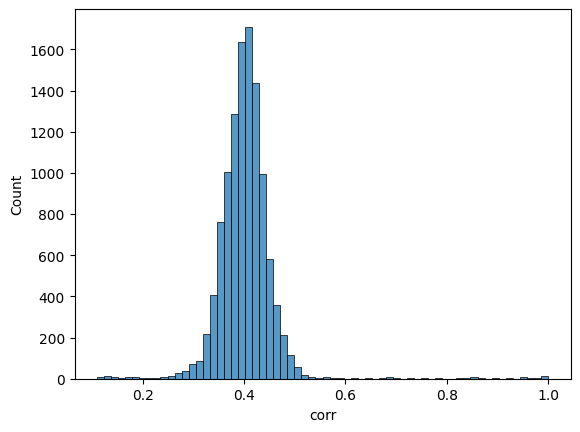

<Figure size 640x480 with 0 Axes>

In [6]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.corr(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()
print(f"mean correlation value: {np.mean(df['corr'])}")
sns.histplot(
    data=df,
    x='corr',
    bins=64
)
plt.show()
plt.clf()

tolerance=0.04


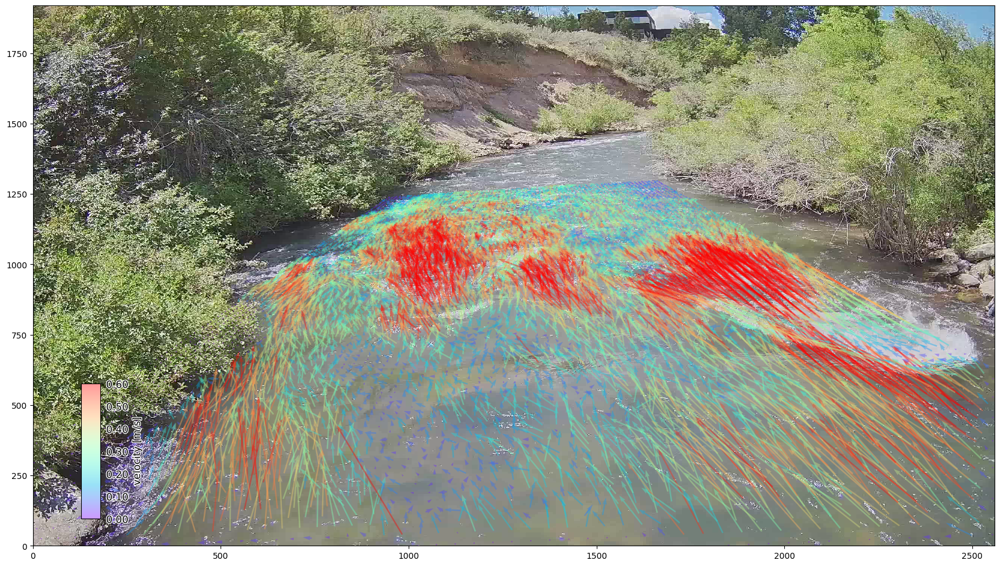

mean vector length: 0.3151544739257456


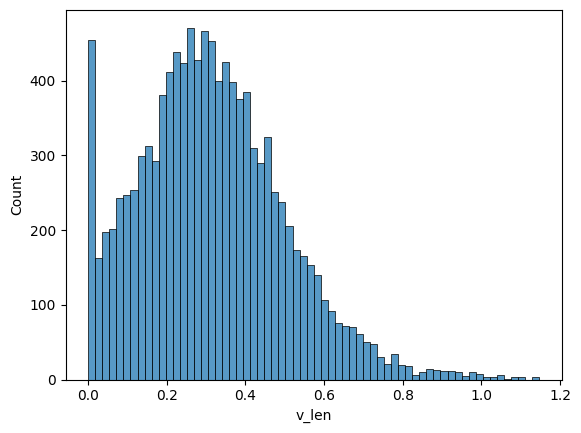

tolerance=0.08


<Figure size 640x480 with 0 Axes>

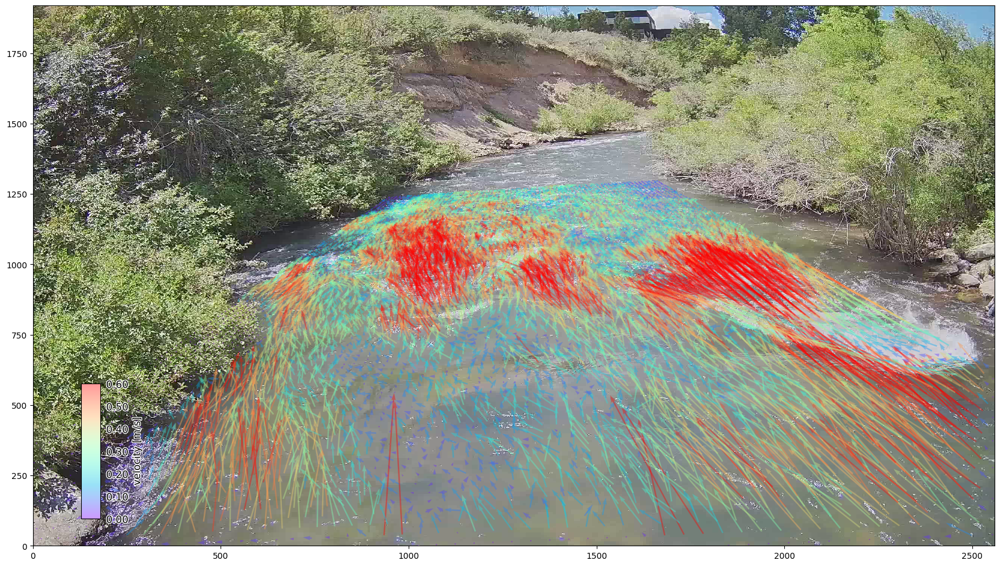

mean vector length: 0.31553736367831486


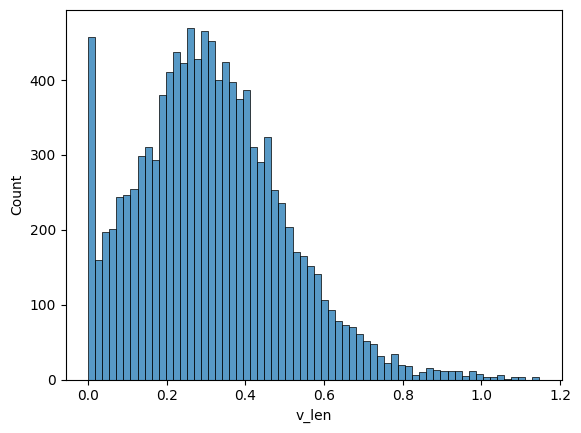

tolerance=0.12


<Figure size 640x480 with 0 Axes>

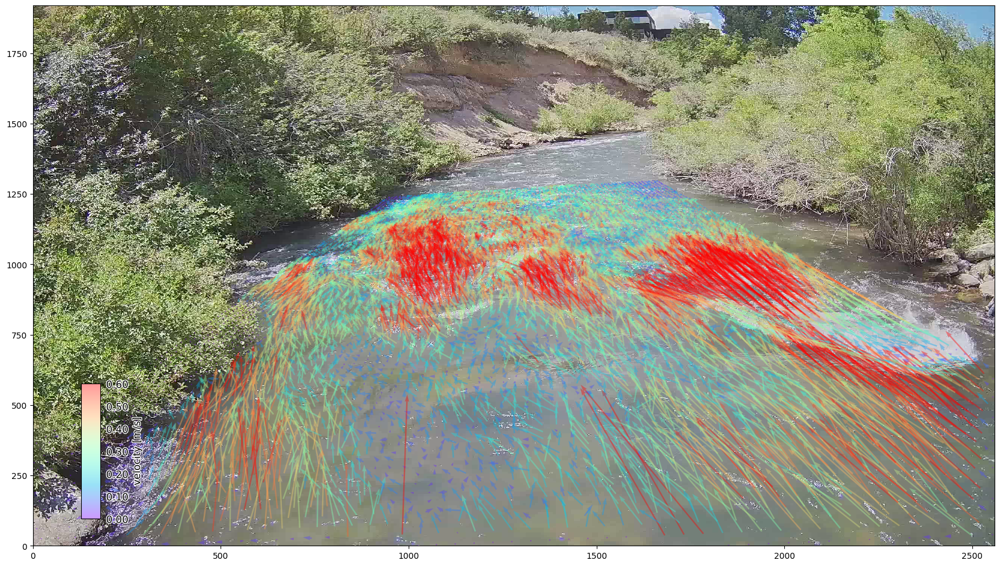

mean vector length: 0.3158133347694565


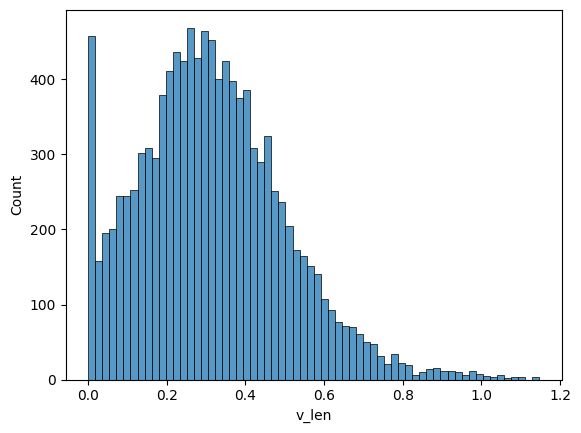

tolerance=0.16


<Figure size 640x480 with 0 Axes>

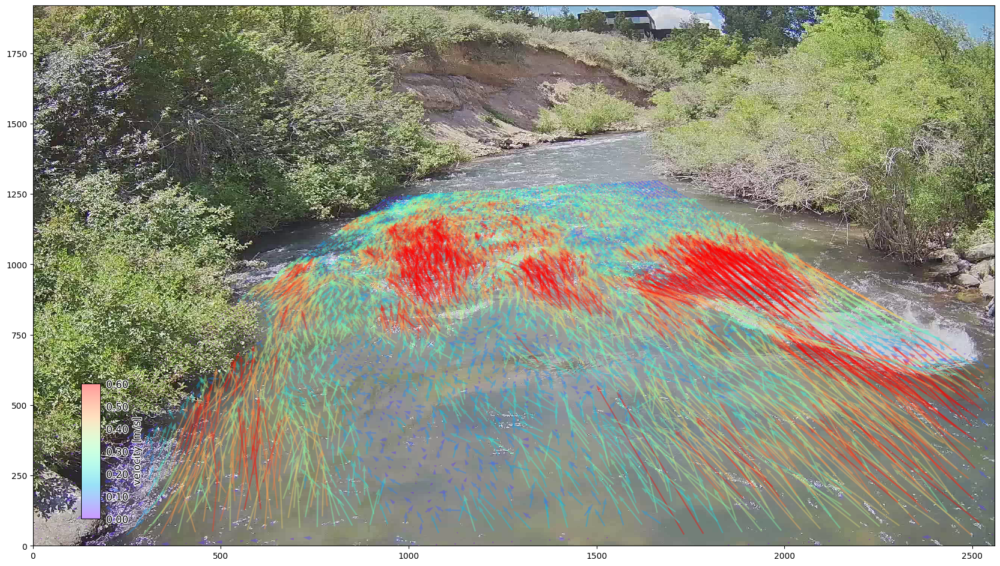

mean vector length: 0.31590593029628156


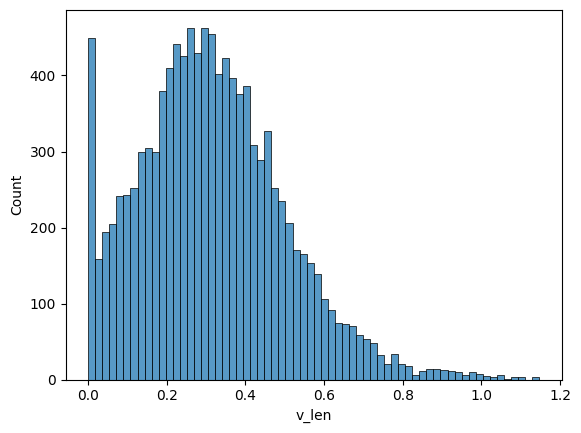

tolerance=0.2


<Figure size 640x480 with 0 Axes>

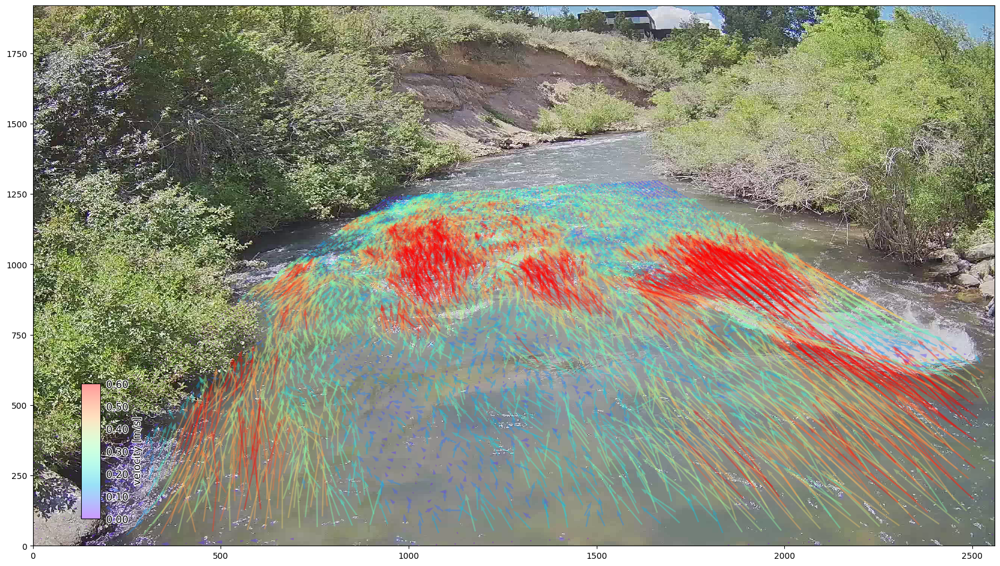

mean vector length: 0.31681947858101556


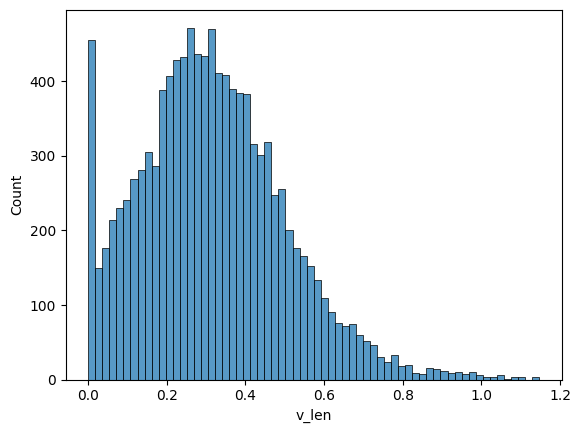

tolerance=0.24


<Figure size 640x480 with 0 Axes>

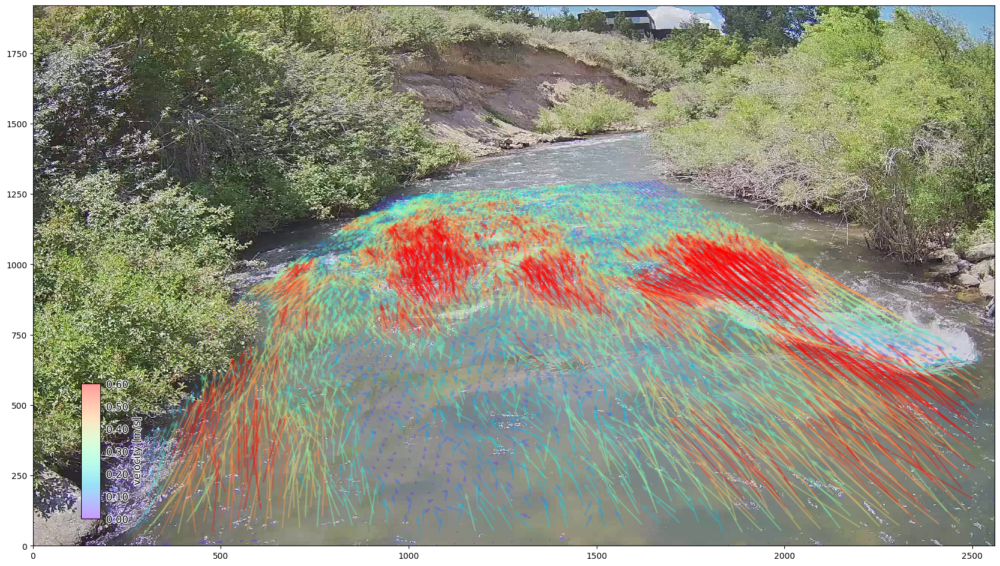

mean vector length: 0.32131703712377335


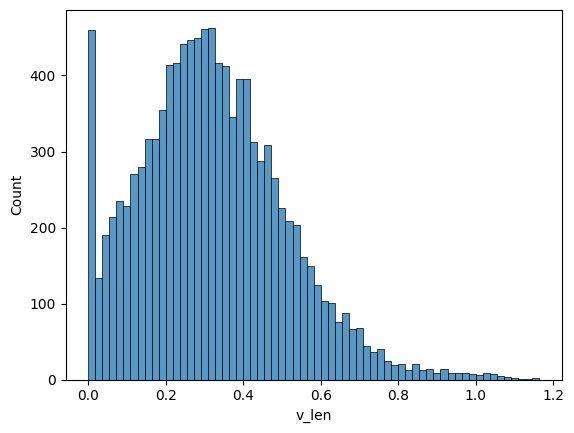

tolerance=0.28


<Figure size 640x480 with 0 Axes>

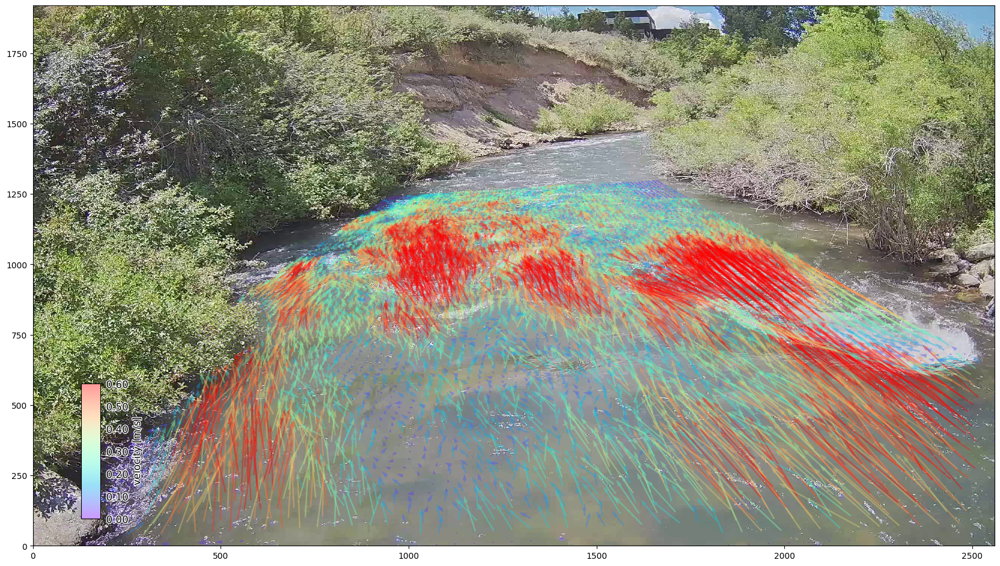

mean vector length: 0.3330969885813285


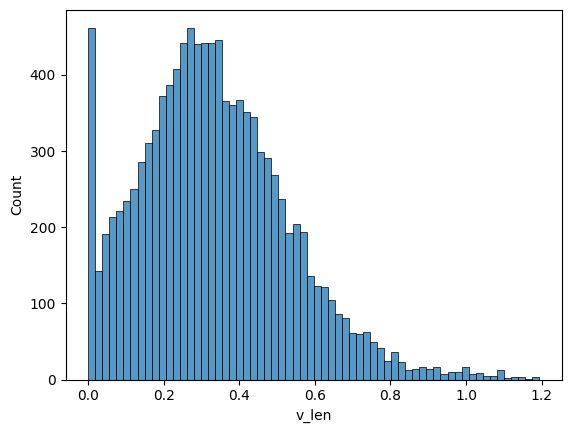

tolerance=0.32


<Figure size 640x480 with 0 Axes>

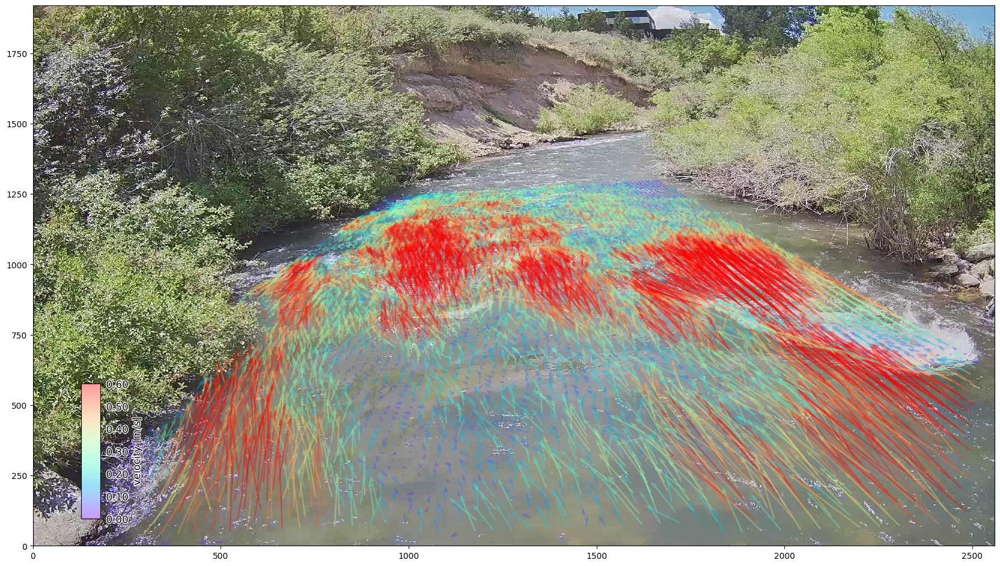

mean vector length: 0.34907379082370066


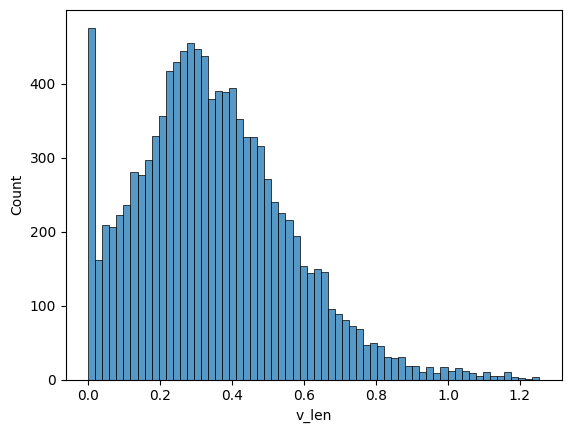

tolerance=0.36


<Figure size 640x480 with 0 Axes>

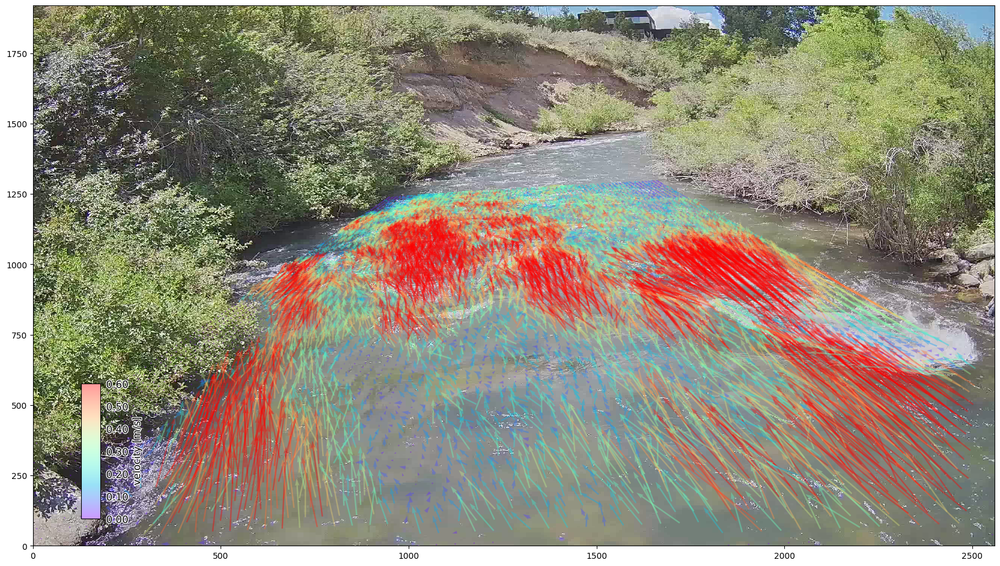

mean vector length: 0.3643090706897784


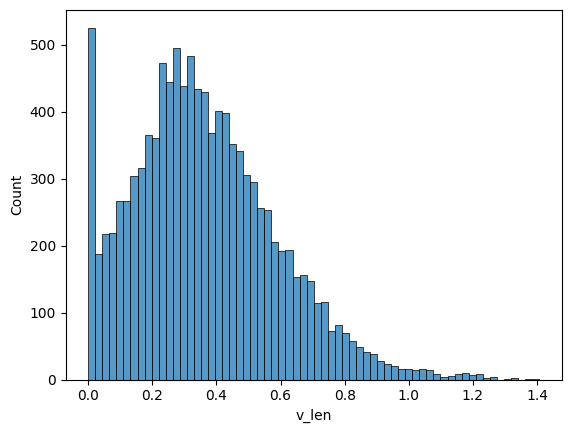

tolerance=0.4


<Figure size 640x480 with 0 Axes>

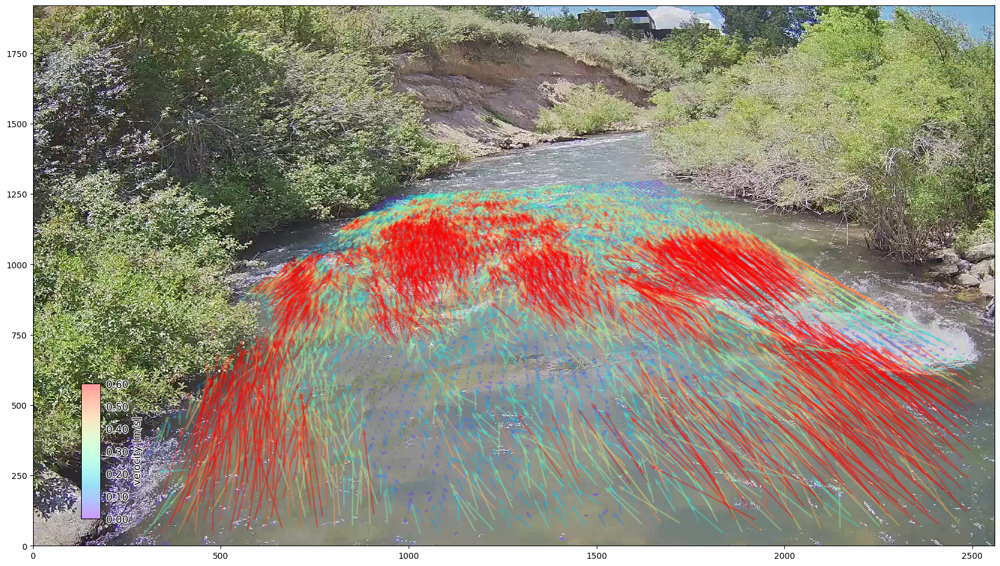

mean vector length: 0.3805219845073637


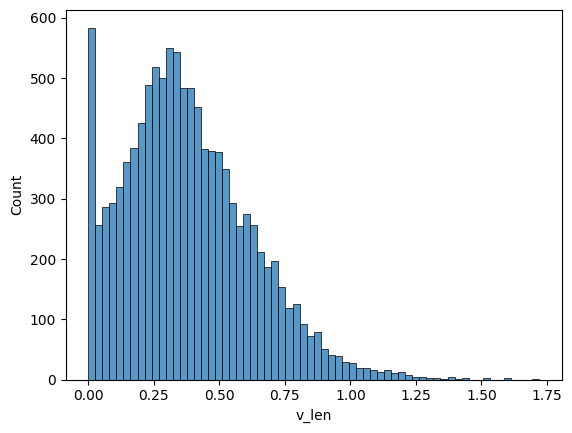

<Figure size 640x480 with 0 Axes>

In [8]:
nums = [i / 100 for i in range(4,44,4)]
for i in nums:
    print(f"tolerance={i}")
    ds = copy.deepcopy(dataset)

    video = pyorc.Video(video_file, start_frame=0, end_frame=125)
    video.camera_config = ds.velocimetry.camera_config

    ds.velocimetry.mask.corr(tolerance=i, inplace=True)

    ds = ds.mean(dim="time", keep_attrs=True)

    p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

    ds.velocimetry.plot(
        ax=p.axes,
        mode="camera",
        alpha=0.4,
        cmap="rainbow",
        scale=200,
        width=0.0015,
        norm=Normalize(vmin=0., vmax=0.6, clip=False),
        add_colorbar=True
    )

    plt.show()
    plt.clf()

    df = ds.to_dataframe().reset_index()
    df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

    print(f"mean vector length: {np.mean(df.v_len)}")
    sns.histplot(
        data=df,
        x='v_len',
        bins=64
    )
    plt.show()
    plt.clf()

In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.angle(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
nums = [(i / 10) * (np.pi/4) for i in range(1,11)]
for i in nums:
    print(f"angle_tolerance={i}")
    ds = copy.deepcopy(dataset)

    video = pyorc.Video(video_file, start_frame=0, end_frame=125)
    video.camera_config = ds.velocimetry.camera_config

    ds.velocimetry.mask.angle(angle_tolerance=i, inplace=True)

    ds = ds.mean(dim="time", keep_attrs=True)

    p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

    ds.velocimetry.plot(
        ax=p.axes,
        mode="camera",
        alpha=0.4,
        cmap="rainbow",
        scale=200,
        width=0.0015,
        norm=Normalize(vmin=0., vmax=0.6, clip=False),
        add_colorbar=True
    )

    plt.show()
    plt.clf()

    df = ds.to_dataframe().reset_index()
    df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

    print(f"mean vector length: {np.mean(df.v_len)}")
    sns.histplot(
        data=df,
        x='v_len',
        bins=64
    )
    plt.show()
    plt.clf()

In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.rolling(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
nums = [i / 10 for i in range(1,11)]
for i in nums:
    print(f"window={i}")
    ds = copy.deepcopy(dataset)

    video = pyorc.Video(video_file, start_frame=0, end_frame=125)
    video.camera_config = ds.velocimetry.camera_config

    ds.velocimetry.mask.rolling(wdw=5, tolerance=i, inplace=True)

    ds = ds.mean(dim="time", keep_attrs=True)

    p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

    ds.velocimetry.plot(
        ax=p.axes,
        mode="camera",
        alpha=0.4,
        cmap="rainbow",
        scale=200,
        width=0.0015,
        norm=Normalize(vmin=0., vmax=0.6, clip=False),
        add_colorbar=True
    )

    plt.show()
    plt.clf()

    df = ds.to_dataframe().reset_index()
    df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

    print(f"mean vector length: {np.mean(df.v_len)}")
    sns.histplot(
        data=df,
        x='v_len',
        bins=64
    )
    plt.show()
    plt.clf()

In [ ]:
nums = [i / 10 for i in range(1,11)]
for i in nums:
    print(f"tolerance={i}")
    ds = copy.deepcopy(dataset)

    video = pyorc.Video(video_file, start_frame=0, end_frame=125)
    video.camera_config = ds.velocimetry.camera_config

    ds.velocimetry.mask.rolling(wdw=5, tolerance=i, inplace=True)

    ds = ds.mean(dim="time", keep_attrs=True)

    p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

    ds.velocimetry.plot(
        ax=p.axes,
        mode="camera",
        alpha=0.4,
        cmap="rainbow",
        scale=200,
        width=0.0015,
        norm=Normalize(vmin=0., vmax=0.6, clip=False),
        add_colorbar=True
    )

    plt.show()
    plt.clf()

    df = ds.to_dataframe().reset_index()
    df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

    print(f"mean vector length: {np.mean(df.v_len)}")
    sns.histplot(
        data=df,
        x='v_len',
        bins=64
    )
    plt.show()
    plt.clf()

In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.outliers(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
modes = ['or', 'and']
nums = [i / 10 for i in range(2,22,2)]
for j in modes:
    for i in nums:
        print(f"tolerance={i}")
        print(f"mode={j}")
        ds = copy.deepcopy(dataset)

        video = pyorc.Video(video_file, start_frame=0, end_frame=125)
        video.camera_config = ds.velocimetry.camera_config

        ds.velocimetry.mask.outliers(tolerance=i, mode=j, inplace=True)

        ds = ds.mean(dim="time", keep_attrs=True)

        p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

        ds.velocimetry.plot(
            ax=p.axes,
            mode="camera",
            alpha=0.4,
            cmap="rainbow",
            scale=200,
            width=0.0015,
            norm=Normalize(vmin=0., vmax=0.6, clip=False),
            add_colorbar=True
        )

        plt.show()
        plt.clf()

        df = ds.to_dataframe().reset_index()
        df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

        print(f"mean vector length: {np.mean(df.v_len)}")
        sns.histplot(
            data=df,
            x='v_len',
            bins=64
        )
        plt.show()
        plt.clf()

In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.variance(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
modes = ['and', 'or']
nums = [i / 10 for i in range(5,55,5)]
for j in modes:
    for i in nums:
        print(f"tolerance={i}")
        print(f"mode={j}")
        ds = copy.deepcopy(dataset)

        video = pyorc.Video(video_file, start_frame=0, end_frame=125)
        video.camera_config = ds.velocimetry.camera_config

        ds.velocimetry.mask.variance(tolerance=i, mode=j, inplace=True)

        ds = ds.mean(dim="time", keep_attrs=True)

        p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

        ds.velocimetry.plot(
            ax=p.axes,
            mode="camera",
            alpha=0.4,
            cmap="rainbow",
            scale=200,
            width=0.0015,
            norm=Normalize(vmin=0., vmax=0.6, clip=False),
            add_colorbar=True
        )

        plt.show()
        plt.clf()

        df = ds.to_dataframe().reset_index()
        df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

        print(f"mean vector length: {np.mean(df.v_len)}")
        sns.histplot(
            data=df,
            x='v_len',
            bins=64
        )
        plt.show()
        plt.clf()

In [ ]:
ds = copy.deepcopy(dataset)

video = pyorc.Video(video_file, start_frame=0, end_frame=125)
video.camera_config = ds.velocimetry.camera_config

ds.velocimetry.mask.count(inplace=True)

ds = ds.mean(dim="time", keep_attrs=True)

p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

ds.velocimetry.plot(
    ax=p.axes,
    mode="camera",
    alpha=0.4,
    cmap="rainbow",
    scale=200,
    width=0.0015,
    norm=Normalize(vmin=0., vmax=0.6, clip=False),
    add_colorbar=True
)

plt.show()
plt.clf()

df = ds.to_dataframe().reset_index()
df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

print(f"mean vector length: {np.mean(df.v_len)}")
sns.histplot(
    data=df,
    x='v_len',
    bins=64
)
plt.show()
plt.clf()

In [ ]:
nums = [i / 10 for i in range(1,11)]
for i in nums:
    print(f"tolerance={i}")
    ds = copy.deepcopy(dataset)

    video = pyorc.Video(video_file, start_frame=0, end_frame=125)
    video.camera_config = ds.velocimetry.camera_config

    ds.velocimetry.mask.count(tolerance=i, inplace=True)

    ds = ds.mean(dim="time", keep_attrs=True)

    p = video.get_frames(method="rgb")[0].frames.plot(mode="camera")

    ds.velocimetry.plot(
        ax=p.axes,
        mode="camera",
        alpha=0.4,
        cmap="rainbow",
        scale=200,
        width=0.0015,
        norm=Normalize(vmin=0., vmax=0.6, clip=False),
        add_colorbar=True
    )

    plt.show()
    plt.clf()

    df = ds.to_dataframe().reset_index()
    df['v_len'] = np.sqrt(df.v_x**2 + df.v_y**2)

    print(f"mean vector length: {np.mean(df.v_len)}")
    sns.histplot(
        data=df,
        x='v_len',
        bins=64
    )
    plt.show()
    plt.clf()